In [24]:
import pandas as pd
import numpy as np
import re
import random
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import classification_report, accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from nltk.tokenize import word_tokenize

nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('averaged_perceptron_tagger_eng')
from nltk import word_tokenize, pos_tag

lemmatizer = WordNetLemmatizer()

# Stopwords list (unchanged)
nltk_sw = ['d', 'm', 'o', 's', 't', 'y', 'll', 're', 've', 'ma', "that'll", 'ain', "she's", "it's", "you're", "you've", "you'll", "youd", 'isn', "isn't", 'aren', "aren't", 'wasn', "wasn't", 'weren', "weren't", 'don', "don't", 'doesn', "doesn't", 'didn', "didn't", 'hasn', "hasn't", 'haven', "haven't", 'hadn', "hadn't", 'mightn', "mightn't", 'mustn', "mustn't", 'needn', "needn't", 'shan', "shan't", 'shouldn', "shouldn't", "shouldve", 'won', "won't", 'wouldn', "wouldn't", 'couldn', "couldn't", 'i', 'me', 'my', 'we', 'our', 'ours', 'you', 'your', 'yours', 'he', 'him', 'his', 'she', 'her', 'hers', 'it', 'its', 'they', 'them', 'their', 'theirs', 'himself', 'herself', 'itself', 'myself', 'yourself', 'yourselves', 'ourselves', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'had', 'has', 'have', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'only', 'own', 'same', 'so', 'than', 'too', 'again', 'further', 'then', 'once', 'can', 'will', 'just', 'should', 'now']
added_sw = ["he's", "he'd", "she'd", "he'll", "she'll", "you'll", "they'd", "could've", "would've", 'could', 'would', "i'm", 'im', "thatll", "shes", "youre", "youve", "youll", "youd", "isnt", "arent", "wasnt", "werent", "dont", "doesnt", "didnt", "hasnt", "havent", "hadnt", "mightnt", "mustnt", "neednt", "shant", "shouldnt", "shouldve", "wont", "wouldnt", "couldnt", 'a','b','c','e','f','g','h','i','j','k','l','n','p','q','r','u','v','w','x','z','lol']
stop_words = added_sw + nltk_sw
punc = ''',.;:?!'\"()[]{}<>|\\/@#^&*_~=+\\n\\t'''

[nltk_data] Downloading package punkt to
[nltk_data]     /Users/richardph911/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/richardph911/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/richardph911/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/richardph911/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     /Users/richardph911/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     /Users/richardph911/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger_eng is already up-to-
[nltk_data]       date!


In [25]:
import json
def load_data(file_path, chunk_size=100000, target_rows=288000):
    try:
        print(f"Attempting to load JSON file from: {file_path}")
        all_data = []
        total_rows = 0
        
        with open(file_path, 'r', encoding='utf-8') as f:
            for i, line in enumerate(f):
                try:
                    all_data.append(json.loads(line.strip()))
                    total_rows += 1
                except json.JSONDecodeError as e:
                    print(f"Skipping invalid JSON line {i + 1}: {e}")
                    continue
        
        print(f"Total rows loaded: {total_rows}")
        
        # Randomly sample to target_rows to approximate 5M non-zero values
        if total_rows > target_rows:
            all_data = random.sample(all_data, target_rows)
            print(f"Sampled down to {target_rows} rows to target 5M non-zero values")
        else:
            print("Dataset smaller than target, using all rows")
        
        df = pd.DataFrame(all_data)
        # print("JSON file loaded successfully. Columns:", df.columns.tolist())
        
        # print("\nFirst 100 rows of the DataFrame:")
        # print(df.head(100))
        
        if 'overall' not in df.columns:
            raise KeyError("'overall' column not found in the dataset")
        if 'reviewText' not in df.columns:
            raise KeyError("'reviewText' column not found in the dataset")
        if 'asin' not in df.columns:
            raise KeyError("'asin' column not found in the dataset")

        label_map = {1: 0, 2: 0, 3: 0, 4: 1, 5: 1}
       
        df['label'] = df['overall'].map(label_map)
        
        if df['label'].isnull().any():
            raise ValueError("Some 'overall' values couldn't be mapped to labels. Invalid 'overall' values found.")

        df['title'] = df.get('reviewerName', '').astype(str)
        df['text'] = df['reviewText'].astype(str).fillna('')
        df['asin'] = df['asin'].astype(str)
        
        split_result = train_test_split(df, test_size=0.2, random_state=42, stratify=df['label'])
        if len(split_result) != 2:
            raise ValueError(f"train_test_split returned {len(split_result)} values, expected 2")
        train_df, test_df = split_result
        
        print("Dataset loaded successfully!")
        print(f"Training dataset shape: {train_df.shape}")
        print(f"Test dataset shape: {test_df.shape}")
        return train_df, test_df
    except Exception as e:
        print(f"Error in load_data: {str(e)}")
        return None, None

In [26]:
def preprocess_text(text):
    if not isinstance(text, str):
        text = str(text)
    
    # Step 1: Handle contractions FIRST
    contraction_map = {
        "won't": "will not", "can't": "cannot", "n't": " not",
        "'re": " are", "'s": " is", "'d": " would", "'ll": " will",
        "'ve": " have", "'m": " am"
    }
    for contraction, expansion in contraction_map.items():
        text = text.replace(contraction, expansion)
    
    # Step 2: Remove URLs/numbers
    text = re.sub(r'https?://\S+|www\.\S+|\S+@\S+|\d+', '', text)
    
    # Step 3: Keep apostrophes for meaningful words
    text = re.sub(r"[^\w\s'-]", '', text)  # Keep letters, whitespace, hyphens, apostrophes
    
    # Step 4: Tokenize and clean
    tokens = word_tokenize(text.lower())
    tokens = [t for t in tokens if t not in stop_words and len(t) > 2]  # Keep words >2 chars
    
    return ' '.join(tokens)


In [27]:
# Vectorize text using TF-IDF
def vectorize_text(train_text, test_text):
    try:
        print("Vectorizing text...")
        vectorizer = TfidfVectorizer(max_features=5000, ngram_range=(1, 2), stop_words=None)
        X_train = vectorizer.fit_transform(train_text)
        X_test = vectorizer.transform(test_text)
        total_non_zeros = X_train.nnz + X_test.nnz
        print(f"Total non-zero values in TF-IDF matrices: {total_non_zeros}")
        return X_train, X_test, vectorizer
    except Exception as e:
        print(f"Error in vectorize_text: {e}")
        return None, None, None

In [30]:
# from nltk.stem import PorterStemmer
# from nltk import pos_tag

# # Expanded sentiment indicators
# POSITIVE_INDICATORS = {
#     "excellent", "amazing", "great", "love", "perfect", "awesome", 
#     "high quality", "good", "best", "recommend", "happy", "satisfied",
#     "durable", "comfortable", "easy use", "works well", "fast",
#     "reliable", "worth", "good value", "pleased", "impressed",
#     "sturdy", "beautiful", "nice", "versatile", "long lasting",
#     "exceed expect", "well made", "happy with", "fantastic", "superb"
# }

# NEGATIVE_INDICATORS = {
#     "not", "awful", "terrible", "poor", "broken", "defective",
#     "waste", "disappoint", "cheap", "flimsy", "useless",
#     "fail", "horrible", "scam", "avoid", "problem", "issue",
#     "not work", "fall apart", "stop working", "missing",
#     "damage", "low quality", "return", "faulty", "unreliable",
#     "overprice", "not recommend", "junk", "ripoff", "leak"
# }

# def get_meaningful_keywords(text, vectorizer, X_new, top_n=5):
#     """Extract meaningful keywords using POS tagging and TF-IDF scores"""
#     feature_names = vectorizer.get_feature_names_out()
#     tfidf_scores = X_new.toarray()[0]
#     stemmer = PorterStemmer()
    
#     # Get top candidates sorted by TF-IDF score
#     top_indices = tfidf_scores.argsort()[-20:][::-1]  # Get more candidates for filtering
#     candidates = [(feature_names[i], tfidf_scores[i]) for i in top_indices if tfidf_scores[i] > 0]
    
#     # Filter by POS and importance
#     meaningful = []
#     seen_stems = set()
    
#     for phrase, score in sorted(candidates, key=lambda x: -x[1]):
#         words = phrase.split()
        
#         # Skip very short phrases
#         if len(phrase) < 3 or any(len(w) < 2 for w in words):
#             continue
            
#         # POS filtering - keep phrases with at least one noun/adj/verb
#         tagged = pos_tag(words)
#         has_meaningful = any(
#             tag.startswith(('NN', 'JJ', 'VB', 'RB'))  # Nouns, Adjectives, Verbs, Adverbs
#             for word, tag in tagged
#         )
        
#         if has_meaningful:
#             # Stem-based deduplication
#             stems = {stemmer.stem(w) for w in words}
#             if not stems.intersection(seen_stems):
#                 meaningful.append(phrase)
#                 seen_stems.update(stems)
                
#         if len(meaningful) >= top_n * 2:  # Get extra for sentiment filtering
#             break
            
#     return meaningful[:top_n]

# def predict_review(review, title, model, vectorizer):
#     review = str(review) if review is not None else ''
#     processed_text = preprocess_text(review)
#     X_new = vectorizer.transform([processed_text])
#     prediction = model.predict(X_new)[0]
    
#     # Get confidence score
#     confidence = None
#     if hasattr(model, "predict_proba"):
#         confidence = model.predict_proba(X_new)[0][1] if prediction == 1 else model.predict_proba(X_new)[0][0]
    
#     sentiment = "Good (Positive)" if prediction == 1 else "Bad (Negative)"
#     result = f"Predicted result: {sentiment}"
#     if confidence is not None:
#         result += f"\nConfidence Score: {confidence:.4f}"
    
#     # Get meaningful keywords
#     keywords = get_meaningful_keywords(processed_text, vectorizer, X_new, top_n=7)
    
#     # Classify keywords by sentiment
#     stemmer = PorterStemmer()
#     positive = []
#     negative = []
    
#     for phrase in keywords:
#         phrase_stems = {stemmer.stem(w) for w in phrase.split()}
        
#         # Check for negative indicators first
#         if any(stemmer.stem(neg) in phrase_stems for neg in NEGATIVE_INDICATORS):
#             negative.append(phrase)
#         # Then check for positive indicators
#         elif any(stemmer.stem(pos) in phrase_stems for pos in POSITIVE_INDICATORS):
#             positive.append(phrase)
    
#     # Generate natural language summary
#     summary_parts = []
#     if positive:
#         if prediction == 1:
#             summary_parts.append(f"highlighting {natural_join(positive[:3])}")
#         else:
#             summary_parts.append(f"noting positives like {natural_join(positive[:2])}")
    
#     if negative:
#         summary_parts.append(f"criticizing {natural_join(negative[:3])}")
    
#     summary = f"Summary: {sentiment} review " + (
#         " and ".join(summary_parts) if summary_parts else "mentioning key features"
#     ) + "."
    
#     return result, prediction, summary

# def natural_join(phrases):
#     """Convert list of phrases to natural language string"""
#     if not phrases:
#         return ""
#     if len(phrases) == 1:
#         return phrases[0]
#     return ", ".join(phrases[:-1]) + " and " + phrases[-1]

In [33]:
### version 2
def predict_review(review, title, model, vectorizer):
    review = str(review) if review is not None else ''
    processed_text = preprocess_text(review)
    X_new = vectorizer.transform([processed_text])
    prediction = model.predict(X_new)[0]
    
    # Get confidence score
    confidence = None
    if hasattr(model, "predict_proba"):
        confidence = model.predict_proba(X_new)[0][1] if prediction == 1 else model.predict_proba(X_new)[0][0]
    
    sentiment = "Good (Positive)" if prediction == 1 else "Bad (Negative)"
    result = f"Predicted result: {sentiment}"
    if confidence is not None:
        result += f"\nConfidence Score: {confidence:.4f}"
    
    # Enhanced feature extraction
    feature_names = vectorizer.get_feature_names_out()
    tfidf_scores = X_new.toarray()[0]
    
    # Get top 10 features instead of 5 for more context
    top_indices = tfidf_scores.argsort()[-10:][::-1]
    top_features = [(feature_names[i], tfidf_scores[i]) 
                   for i in top_indices if tfidf_scores[i] > 0]
    

    # Extract just the top-scoring words
    keywords = []
    for word, score in top_features:
        tokens = word_tokenize(word)
        if not tokens:
            continue
        tag = pos_tag(tokens)[0][1]
        if tag.startswith(('NN', 'VB', 'JJ')) and len(word) > 3:
            keywords.append((word, score))

    # Remove repeated words
    seen = set()
    final_keywords = []
    for word, score in keywords:
        if word not in seen:
            final_keywords.append(word)
        seen.add(word)
        if len(final_keywords) >= 5:
            break

    # Classify phrases
    negative_indicators = {"not", "foul", "awful", "waste", "worse", "poor"}
    positive = [w for w in final_keywords if not any(n in w for n in negative_indicators)]
    negative = [w for w in final_keywords if any(n in w for n in negative_indicators)]

    # Build summary
    summary_parts = []
    if positive:
        summary_parts.append(f"highlighting {natural_join(positive)}")
    if negative:
        summary_parts.append(f"criticizing {natural_join(negative)}")

    summary = f"Summary: {sentiment} review " + (
        " and ".join(summary_parts) if summary_parts else "without specific mentions"
    ) + "."

    
    # # Sort by TF-IDF score and phrase length
    # top_features.sort(key=lambda x: (-x[1], -len(x[0].split())))
    
    # # Filter and group meaningful phrases
    # meaningful_phrases = []
    # seen_words = set()
    
    # for phrase, score in top_features:
    #     words = phrase.split()
    #     # Skip if already seen or too short
    #     if (len(phrase) < 4 or 
    #         any(word in seen_words for word in words)):
    #         continue
            
    #     meaningful_phrases.append(phrase)
    #     seen_words.update(words)
    #     if len(meaningful_phrases) >= 5:  # Limit to top 5 most meaningful
    #         break
    
    # # Classify phrases
    # negative_indicators = {"not_", "foul", "adultery", "awful", "waste", "worse"}
    # positive_phrases = [p for p in meaningful_phrases 
    #                    if not any(neg in p for neg in negative_indicators)]
    # negative_phrases = [p for p in meaningful_phrases 
    #                     if any(neg in p for neg in negative_indicators)]
    
    # # Generate more natural summary
    # summary_parts = []
    # if positive_phrases:
    #     if prediction == 1:
    #         summary_parts.append(f"highlighting {natural_join(positive_phrases)}")
    #     else:
    #         summary_parts.append(f"noting positives like {natural_join(positive_phrases)}")
    
    # if negative_phrases:
    #     summary_parts.append(f"criticizing {natural_join(negative_phrases)}")
    
    # summary = f"Summary: {sentiment} review " + (
    #     " and ".join(summary_parts) if summary_parts else "without specific mentions"
    # ) + "."
    
    return result, prediction, summary

def natural_join(phrases):
    """Convert list of phrases to natural language string"""
    if len(phrases) == 1:
        return phrases[0]
    return ", ".join(phrases[:-1]) + " and " + phrases[-1]

Attempting to load JSON file from: Office_Products.json
Total rows loaded: 5581313
Sampled down to 280000 rows to target 5M non-zero values
Dataset loaded successfully!
Training dataset shape: (224000, 15)
Test dataset shape: (56000, 15)
Loaded
Training model here
Vectorizing text...
Total non-zero values in TF-IDF matrices: 4988994

Training Logistic Regression...
Logistic Regression Test Performance:
              precision    recall  f1-score   support

           0       0.84      0.71      0.77     12191
           1       0.92      0.96      0.94     43809

    accuracy                           0.91     56000
   macro avg       0.88      0.84      0.86     56000
weighted avg       0.91      0.91      0.91     56000


Training Naive Bayes...
Naive Bayes Test Performance:
              precision    recall  f1-score   support

           0       0.84      0.57      0.68     12191
           1       0.89      0.97      0.93     43809

    accuracy                           0.88     

/var/folders/dx/dw4w48cs54j90_49_44ls9tw0000gn/T/ipykernel_68301/3453327022.py:46: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x=model_names, y=accuracies, palette='viridis')



Product ASIN: B002JEB162

Positive Reviews:
Title: Mike
Text: mike direct replacement old models used factories worked existing drivers windows unix tandem
Predicted result: Good (Positive)
Confidence Score: 0.8372
Summary: Good (Positive) review highlighting existing, direct, models, drivers and mike.


Negative Reviews:
Overall Summary for Product:
Sentiment: 1/1 positive
Key Themes: Good (Positive) review highlighting existing, direct, models, drivers and mike.
--------------------------------------------------

Product ASIN: B01G6IOEF6

Positive Reviews:
Title: Cat Michaels
Text: cat michaels pleased surprised way monitor fits well desk excellent storage clutter not realize organized
Predicted result: Good (Positive)
Confidence Score: 0.9962
Summary: Good (Positive) review highlighting clutter, realize, monitor, surprised and storage.

Title: Serj
Text: serj very high quality material perfect
Predicted result: Good (Positive)
Confidence Score: 0.9942
Summary: Good (Positive) revie

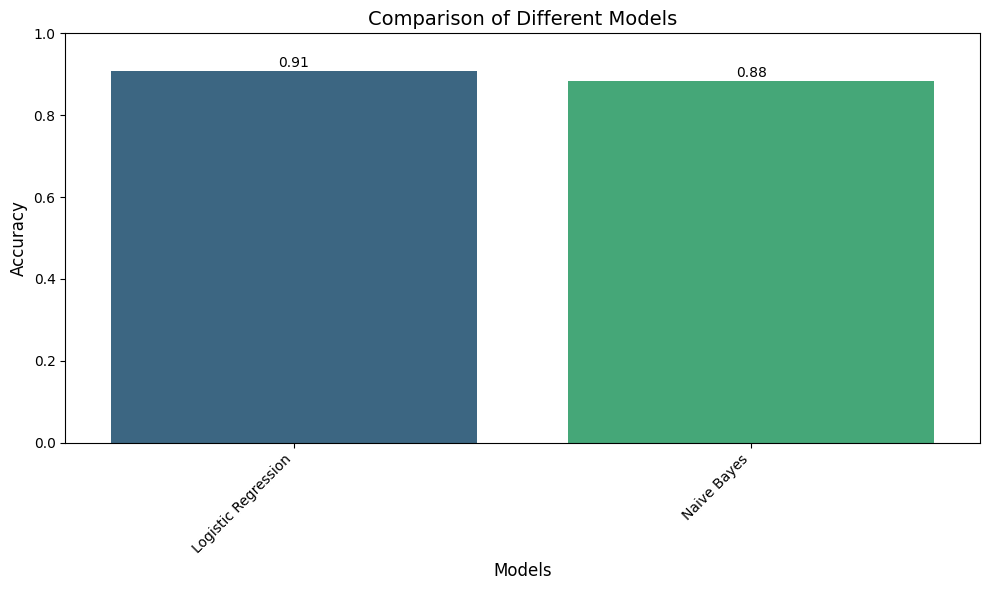

In [34]:


# Main execution (unchanged)
if __name__ == "__main__":
    json_path = 'Office_Products.json'
    train_df, test_df = load_data(json_path)
    print("Loaded")
    if train_df is not None and test_df is not None:
        print("Training model here")
        train_df['reviews'] = train_df['title'].astype(str).fillna('') + ' ' + train_df['text'].astype(str).fillna('')
        test_df['reviews'] = test_df['title'].astype(str).fillna('') + ' ' + test_df['text'].astype(str).fillna('')
        train_df['text'] = train_df['reviews'].apply(preprocess_text)
        test_df['text'] = test_df['reviews'].apply(preprocess_text)
        train_df = train_df.drop(columns=['reviews'])
        test_df = test_df.drop(columns=['reviews'])
        # Vectorize vector
        X_train_full, X_test, vectorizer = vectorize_text(train_df['text'], test_df['text'])
        y_train_full = train_df['label'].values
        y_test = test_df['label'].values
        
        models = {
            "Logistic Regression": LogisticRegression(max_iter=1000),
            "Naive Bayes": MultinomialNB(),
        }
        
        X_train, X_val, y_train, y_val = train_test_split(
            X_train_full, y_train_full, test_size=0.2, random_state=42, stratify=y_train_full
        )
        accuracies = []
        model_names = list(models.keys())
        trained_models = {}

        for name, model in models.items():
            print(f"\nTraining {name}...")
            model.fit(X_train, y_train)
            trained_models[name] = model
            y_test_pred = model.predict(X_test)
            accuracy = accuracy_score(y_test, y_test_pred)
            accuracies.append(accuracy)
            print(f"{name} Test Performance:")
            print(classification_report(y_test, y_test_pred))

        best_model_name = model_names[np.argmax(accuracies)]
        best_model = trained_models[best_model_name]
        print(f"\nBest Model: {best_model_name} with Test Accuracy: {max(accuracies):.4f}")

        plt.figure(figsize=(10, 6))
        ax = sns.barplot(x=model_names, y=accuracies, palette='viridis')
        plt.xlabel('Models', fontsize=12)
        plt.ylabel('Accuracy', fontsize=12)
        plt.title('Comparison of Different Models', fontsize=14)
        plt.ylim(0, 1)
        plt.xticks(rotation=45, ha='right', fontsize=10)
        for p in ax.patches:
            ax.annotate(f"{p.get_height():.2f}",
                        (p.get_x() + p.get_width() / 2., p.get_height()),
                        ha='center', va='center', fontsize=10, color='black',
                        xytext=(0, 6), textcoords='offset points')
        plt.tight_layout()
        plt.savefig('model_comparison.png')

        from collections import defaultdict
        grouped_reviews = defaultdict(lambda: {"positive": [], "negative": [], "summaries": []})

        reviews_to_predict = test_df.to_dict('records')
        for review_data in reviews_to_predict:
            try:
                asin = review_data["asin"]
                title = review_data["title"]
                text = review_data["text"]
                result, prediction, summary = predict_review(text, title, best_model, vectorizer)
                sentiment = "positive" if prediction == 1 else "negative"
                review_info = {
                    "title": title,
                    "text": text,
                    "result": result,
                    "summary": summary
                }
                grouped_reviews[asin][sentiment].append(review_info)
                grouped_reviews[asin]["summaries"].append(summary)
            except Exception as e:
                print(f"Error processing review for ASIN {asin}: {e}")

        for asin, data in grouped_reviews.items():
            print(f"\nProduct ASIN: {asin}")
            print("\nPositive Reviews:")
            for review in data["positive"]:
                print(f"Title: {review['title']}")
                print(f"Text: {review['text']}")
                print(f"{review['result']}")
                print(f"{review['summary']}\n")
            
            print("\nNegative Reviews:")
            for review in data["negative"]:
                print(f"Title: {review['title']}")
                print(f"Text: {review['text']}")
                print(f"{review['result']}")
                print(f"{review['summary']}\n")
            
            print("Overall Summary for Product:")
            positive_count = len(data["positive"])
            negative_count = len(data["negative"])
            total_reviews = positive_count + negative_count
            if total_reviews > 0:
                sentiment_ratio = f"{positive_count}/{total_reviews} positive"
                summary_text = " ".join([s.split("Summary: ")[1] for s in data["summaries"]])
                print(f"Sentiment: {sentiment_ratio}")
                print(f"Key Themes: {summary_text}")
            else:
                print("No reviews available for summarization.")
            print("-" * 50)